<a href="https://colab.research.google.com/github/your-lithium/projector-project/blob/main/project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# formulating the task

### task:

create a model to predict an automobile's price

### validation strategy:
k-fold validation


### metric:
rmse — regression task with some outliers

### dataset:

self-created (parsed from auto.ria)

### baseline

mean of every respective car make's price

# creating the dataset

## imports

In [ ]:
import requests
from bs4 import BeautifulSoup

In [ ]:
import logging
logging.getLogger('urllib3').setLevel(logging.ERROR)

In [ ]:
import time

In [ ]:
import numpy as np
import pandas as pd

In [ ]:
import re

In [ ]:
import ast

## scraping

In [ ]:
def scrape_cars():
    url = 'https://auto.ria.com/uk/car/used/'
    headers = {'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/58.0.3029.110 Safari/537.3'}

    cars_list = []

    for i in range(3400):
        start = time.time()
        response = requests.get((url + '?page=' + str(i+1)), headers=headers)

        if response.status_code == 200:
            soup = BeautifulSoup(response.content, 'html.parser')
            car_elements = soup.find_all('section', class_='ticket-item')

            for car in car_elements:
                car_info = {}

                div = car.find('div', class_='hide')
                car_info['equipment'] = div.get('data-equipment-name')
                car_info['generation'] = div.get('data-generation-name')
                car_info['mark'] = div.get('data-mark-name')
                car_info['model'] = div.get('data-model-name')
                car_info['modification'] = div.get('data-modification-name')
                car_info['year'] = div.get('data-year')

                div = car.find('div', class_='content-bar')
                car_info['link'] = div.find('a').get('href')

                div = div.find('div', class_='content')

                div_price = div.find('div', class_='price-ticket')
                car_info['currency'] = div_price.get('data-main-currency')
                car_info['price'] = div_price.get('data-main-price')

                div = div.find('div', class_='definition-data')

                div_details = div.find('ul', class_='unstyle characteristic')
                div_details = div_details.find_all('li')
                car_info['mileage'] = div_details[0].get_text()
                car_info['place'] = div_details[1].get_text()
                car_info['gearbox'] = div_details[3].get_text()

                additional_info = {}
                div_info = div.find('div', class_='base_information')
                if div_info:
                    additional_info['number'] = bool(div_info.find(class_='state-num ua'))
                    additional_info['vin'] = bool(div_info.find(class_='label-vin'))
                    additional_info['vin_checked'] = bool(div_info.find(class_='popup __larr financeua'))

                    details = div_info.find_all(class_='item')
                    if details:
                        additional_info['details'] = [detail.get_text() for detail in details]

                    car_info['additional_info'] = additional_info
                else:
                    car_info['additional_info'] = None

                div_element = div.find(class_='descriptions-ticket')
                car_info['description'] = div_element.find('span').get_text()

                # continue scraping in separate car page
                # car_response = requests.get(link, headers=headers)
                # soup = BeautifulSoup(car_response.content, 'html.parser')

                # info = soup.find('div', 'technical-info')
                # print(info)

                # car_info['engine_type'] = soup.
                # car_info['engine_capacity'] =

                cars_list.append(car_info)
        end = time.time()
        print(end - start)

    return cars_list

cars = scrape_cars()

In [ ]:
cars

In [ ]:
data = pd.DataFrame(cars)

In [ ]:
data

,equipment,generation,mark,model,modification,year,link,currency,price,mileage,place,gearbox,additional_info,description
0,Base,IV покоління/J (FL),Opel,Astra,1.6 АТ (115 к.с.),2016,https://auto.ria.com/uk/auto_opel_astra_364925...,USD,13400,50 тис. км,Одеса ( від ),Автомат,"{'number': True, 'vin': True, 'vin_checked': T...",EXLUSIVE!!! НОВАЯ МАШИНА!!! 49 Т.КМ ОРИГИНАЛЬН...
1,,E70 (FL),BMW,X5,,2013,https://auto.ria.com/uk/auto_bmw_x5_36532333.html,USD,22000,181 тис. км,Кривий Ріг ( від ),Автомат,"{'number': True, 'vin': True, 'vin_checked': T...",Продам ОФИЦИАЛЬНЫЙ Х 5\nОригинальный пробег\nА...
2,Base,I покоління,Hyundai,i40,2.0 AT (166 к.с.),2012,https://auto.ria.com/uk/auto_hyundai_i40_36530...,USD,16500,19 тис. км,Одеса ( від ),Автомат,"{'number': True, 'vin': True, 'vin_checked': T...",ЕКСКЛЮЗИВНЕ ОФІЦІЙНЕ АВТО!!!Машина нова!!! 190...
3,M Package,F15,BMW,X5,M50d Steptronic (381 к.с.) xDrive,2014,https://auto.ria.com/uk/auto_bmw_x5_36302146.html,USD,33999,250 тис. км,Одеса ( від ),Автомат,"{'number': True, 'vin': True, 'vin_checked': T...",Обмін бажано на G-05 з моею доплатою .Продаемо...
4,Base,G20,BMW,3 Series,320d Steptronic (190 к.с.) xDrive,2019,https://auto.ria.com/uk/auto_bmw_3_series_3646...,USD,33500,142 тис. км,Одеса ( від ),Автомат,"{'number': True, 'vin': True, 'vin_checked': T...",Ціна за налічку без торгу!!!!ОФІЦІЙНИЙ БАВАРЕЦ...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67993,,III покоління (FL),Skoda,Superb,2.0 TSI 7DSG (190 к.с.),2023,https://auto.ria.com/uk/newauto/auto-skoda-sup...,USD,35748,без пробігу,Рівне ( від ),Роботизована,"{'number': False, 'vin': False, 'vin_checked':...",\n
67994,Business+,IV покоління/L10 (FL),Lexus,GS,200t AT (245 к.с.),2016,https://auto.ria.com/uk/auto_lexus_gs_36326499...,USD,23490,120 тис. км,Львів ( від ),Автомат,"{'number': False, 'vin': True, 'vin_checked': ...",Код товару: 42826.\n\nМожливий обмін на будь-я...
67995,,,Opel,Astra,,1999,https://auto.ria.com/uk/auto_opel_astra_360417...,USD,3700,318 тис. км,Миколаїв ( від ),Ручна / Механіка,"{'number': True, 'vin': True, 'vin_checked': T...",Авто в доброму стані. Мала витрата пального. Н...
67996,Bose,III покоління (2nd FL),Renault,Scenic,1.6 dCi MT (130 к.с.) Start&Stop,2013,https://auto.ria.com/uk/auto_renault_scenic_36...,USD,9550,175 тис. км,Київ ( від ),Ручна / Механіка,"{'number': False, 'vin': False, 'vin_checked':...",Продам Renault Scenic 1.6 DCI BOSE\nМаксимальн...


In [ ]:
data.to_csv('/content/cars.csv')

## beautifying

In [ ]:
data = pd.read_csv('/content/cars.csv', index_col=0)

In [ ]:
cols = data.columns.tolist()
cols

['Unnamed: 0',
 'equipment',
 'generation',
 'mark',
 'model',
 'modification',
 'year',
 'link',
 'currency',
 'price',
 'mileage',
 'place',
 'gearbox',
 'additional_info',
 'description']

In [ ]:
cols = ['currency', 'price', 'link', 'mark', 'model', 'year', 'modification',
        'equipment', 'generation', 'mileage', 'place', 'gearbox',
        'additional_info', 'description']

data = data[cols]

In [ ]:
def clean_place(place):
    pattern = '(.+) \( від \)'
    matched = re.search(pattern, place)

    if matched:
      return matched.group(1)
    else:
      return None

data["place"] = data["place"].apply(lambda x: clean_place(x))

In [ ]:
def clean_mileage(mileage):
    pattern = '(\d+) тис\. км'
    matched = re.search(pattern, mileage)

    if matched:
        return int(matched.group(1)) * 1000
    else:
        pattern = ' без пробігу '
        matched = re.search(pattern, mileage)
        if matched:
            return 0
        else:
            print(mileage)
            return None

data["mileage"] = data["mileage"].apply(lambda x: clean_mileage(x))

In [ ]:
loan_list = ['Кредит до 1 року під 0.01%',
            'Кредит до 2 років під 0.01%',
            'Кредит до 3 років під 0.01%',
            'Кредит до 4 років під 0.01%',
            'Кредит до 5 років під 0.01%',
            'Кредит до 5 років під 14.9%']

In [ ]:
def decipher_additional_info(additional_info):
    additional_info = ast.literal_eval(additional_info)

    number = additional_info['number']
    vin = additional_info['vin']
    vin_checked = additional_info['vin_checked']

    try:
        details = additional_info['details']

        if ' Акція' in details or 'Акція' in details:
            promo = True
        else:
            promo = False

        if ' Взято в кредит' in details or 'Взято в кредит' in details:
            on_credit = True
        else:
            on_credit = False

        if '7 років гарантії' in details:
            warranty = True
        else:
            warranty = False

        if 'Без першої реєстрації' in details:
            no_registration = True
        else:
            no_registration = False

        if 'Був в ДТП' in details:
            accident = True
        else:
            accident = False

        if 'Доступно в лізинг' in details:
            lease_available = True
        else:
            lease_available = False

        if 'Зафіксований курс' in details:
            fixed_rate = True
        else:
            fixed_rate = False

        if 'Краща ціна' in details:
            best_price = True
        else:
            best_price = False

        if 'Не на ходу' in details:
            in_running_order = False
        else:
            in_running_order = True

        if 'Онлайн бронювання' in details:
            online_booking = True
        else:
            online_booking = False

        if 'Остання пропозиція' in details:
            last_offer = True
        else:
            last_offer = False

        if 'Продає AUTO.RIA' in details:
            seller_is_auto_ria = True
        else:
            seller_is_auto_ria = False

        loan = next((element for element in loan_list if element in details), None)
        if loan:
            pattern = 'Кредит до (\d) рок(?:у|ів) під (\d{1,2}\.\d{1,2})%'
            matched = re.search(pattern, loan)
            loan_years = int(matched.group(1))
            loan_rate = float(matched.group(2))
        else:
            loan_years = None
            loan_rate = None

    except KeyError:
        promo = False
        on_credit = False
        warranty = False
        no_registration = False
        accident = False
        lease_available = False
        fixed_rate = False
        best_price = False
        in_running_order = True
        online_booking = False
        last_offer = False
        seller_is_auto_ria = False
        loan_years = None
        loan_rate = None

    return number, vin, vin_checked, promo, on_credit, warranty, no_registration, accident, lease_available, fixed_rate, best_price, in_running_order, online_booking, last_offer, seller_is_auto_ria, loan_years, loan_rate

In [ ]:
new_columns = ['number', 'vin', 'vin_checked', 'promo', 'on_credit', 'warranty', 'no_registration', 'accident', 'lease_available', 'fixed_rate', 'best_price', 'in_running_order', 'online_booking', 'last_offer', 'seller_is_auto_ria', 'loan_years', 'loan_rate']
new_series = data['additional_info'].apply(lambda x: decipher_additional_info(x))

new_data = pd.DataFrame(new_series.tolist(), columns=new_columns)
data = pd.concat([data, new_data], axis=1)
data.drop(columns=['additional_info'], inplace=True)

In [ ]:
data

,currency,price,link,mark,model,year,modification,equipment,generation,mileage,...,accident,lease_available,fixed_rate,best_price,in_running_order,online_booking,last_offer,seller_is_auto_ria,loan_years,loan_rate
0,USD,13400,https://auto.ria.com/uk/auto_opel_astra_364925...,Opel,Astra,2016,1.6 АТ (115 к.с.),Base,IV покоління/J (FL),50000,...,False,False,False,False,True,False,False,False,NaN,NaN
1,USD,22000,https://auto.ria.com/uk/auto_bmw_x5_36532333.html,BMW,X5,2013,NaN,NaN,E70 (FL),181000,...,False,False,False,False,True,False,False,False,NaN,NaN
2,USD,16500,https://auto.ria.com/uk/auto_hyundai_i40_36530...,Hyundai,i40,2012,2.0 AT (166 к.с.),Base,I покоління,19000,...,False,False,False,False,True,False,False,False,NaN,NaN
3,USD,33999,https://auto.ria.com/uk/auto_bmw_x5_36302146.html,BMW,X5,2014,M50d Steptronic (381 к.с.) xDrive,M Package,F15,250000,...,True,False,False,False,True,False,False,False,NaN,NaN
4,USD,33500,https://auto.ria.com/uk/auto_bmw_3_series_3646...,BMW,3 Series,2019,320d Steptronic (190 к.с.) xDrive,Base,G20,142000,...,False,False,False,False,True,False,False,False,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67993,USD,35748,https://auto.ria.com/uk/newauto/auto-skoda-sup...,Skoda,Superb,2023,2.0 TSI 7DSG (190 к.с.),NaN,III покоління (FL),0,...,False,True,False,False,True,False,False,False,3.0,0.01
67994,USD,23490,https://auto.ria.com/uk/auto_lexus_gs_36326499...,Lexus,GS,2016,200t AT (245 к.с.),Business+,IV покоління/L10 (FL),120000,...,False,False,False,False,True,False,False,False,NaN,NaN
67995,USD,3700,https://auto.ria.com/uk/auto_opel_astra_360417...,Opel,Astra,1999,NaN,NaN,NaN,318000,...,False,False,False,False,True,False,False,False,NaN,NaN
67996,USD,9550,https://auto.ria.com/uk/auto_renault_scenic_36...,Renault,Scenic,2013,1.6 dCi MT (130 к.с.) Start&Stop,Bose,III покоління (2nd FL),175000,...,False,False,False,False,True,False,False,False,NaN,NaN


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 67998 entries, 0 to 67997
Data columns (total 30 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   currency            67998 non-null  object 
 1   price               67998 non-null  int64  
 2   link                67998 non-null  object 
 3   mark                67996 non-null  object 
 4   model               67990 non-null  object 
 5   year                67998 non-null  int64  
 6   modification        35685 non-null  object 
 7   equipment           24071 non-null  object 
 8   generation          49833 non-null  object 
 9   mileage             67998 non-null  int64  
 10  place               67998 non-null  object 
 11  gearbox             67998 non-null  object 
 12  description         62765 non-null  object 
 13  number              67998 non-null  bool   
 14  vin                 67998 non-null  bool   
 15  vin_checked         67998 non-null  bool   
 16  prom

In [ ]:
data.to_csv('/content/cars.csv')

# feature engineering

In [ ]:
data = pd.read_csv('/content/cars (2).csv', index_col=0)

In [ ]:
data.head()

,currency,price,link,mark,model,year,modification,equipment,generation,mileage,...,accident,lease_available,fixed_rate,best_price,in_running_order,online_booking,last_offer,seller_is_auto_ria,loan_years,loan_rate
0,USD,13400,https://auto.ria.com/uk/auto_opel_astra_364925...,Opel,Astra,2016,1.6 АТ (115 к.с.),Base,IV покоління/J (FL),50000,...,False,False,False,False,True,False,False,False,NaN,NaN
1,USD,22000,https://auto.ria.com/uk/auto_bmw_x5_36532333.html,BMW,X5,2013,NaN,NaN,E70 (FL),181000,...,False,False,False,False,True,False,False,False,NaN,NaN
2,USD,16500,https://auto.ria.com/uk/auto_hyundai_i40_36530...,Hyundai,i40,2012,2.0 AT (166 к.с.),Base,I покоління,19000,...,False,False,False,False,True,False,False,False,NaN,NaN
3,USD,33999,https://auto.ria.com/uk/auto_bmw_x5_36302146.html,BMW,X5,2014,M50d Steptronic (381 к.с.) xDrive,M Package,F15,250000,...,True,False,False,False,True,False,False,False,NaN,NaN
4,USD,33500,https://auto.ria.com/uk/auto_bmw_3_series_3646...,BMW,3 Series,2019,320d Steptronic (190 к.с.) xDrive,Base,G20,142000,...,False,False,False,False,True,False,False,False,NaN,NaN


## imports

In [ ]:
import numpy as np
import pandas as pd

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(rc={'figure.figsize':(14,9)})
%matplotlib inline

In [ ]:
!pip install pydantic_settings

In [ ]:
!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

     / 17.8 MB 23.7 MB/s 0:00:02
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 2.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 8.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 293.3/293.3 kB 5.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 6.2 MB/s eta 0:00:00
  Created wheel for ydata-profiling: filename=ydata_profiling-0.0.dev0-py2.py3-none-any.whl size=357942 sha256=ed65db4ce46fe0176cc612dff8fe2a134481ea86830a752b89e3b07840cb2e93
  Stored in directory: /tmp/pip-ephem-wheel-cache-tcd41791/wheels/07/29/61/f533cc7cbd0a97efb2d1b94d3254a3e859a949367ba842577b
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27080 sha256=b477327172e298e3405bdf842bc00715d78a23dc0784b27d7101a1b1a8471433
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5

In [ ]:
from pydantic_settings import BaseSettings
from pandas_profiling import ProfileReport

<ipython-input-13-18af063939a6>:2: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  from pandas_profiling import ProfileReport


In [ ]:
from sklearn import preprocessing

In [ ]:
import re

In [ ]:
!pip install xgbfir

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 159.9/159.9 kB 1.7 MB/s eta 0:00:00


In [ ]:
import xgbfir
import xgboost as xgb

In [ ]:
from sklearn.model_selection import StratifiedKFold

In [ ]:
# !pip install --upgrade scikit-learn

In [ ]:
from sklearn.impute import SimpleImputer

In [ ]:
import pickle

## report

In [ ]:
report = ProfileReport(data, explorative=True)
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

1. drop duplicates
2. drop columns with large imbalance
3. drop some columns with high corellation
4. drop rows with unusual missing values
5. work with outliers (price)

## working on existing features

In [ ]:
# 1. drop duplicates
data.drop_duplicates(inplace=True)

In [ ]:
# 2. drop columns with large imbalance
columns_to_drop = ['promo', 'on_credit', 'warranty', 'no_registration',
                   'fixed_rate', 'best_price', 'in_running_order',
                   'online_booking', 'last_offer']
data.drop(columns=columns_to_drop, inplace=True)

In [ ]:
# 3. drop some columns with high corellation
# none left to drop after dropping imbalances imo

In [ ]:
# 4. drop rows with unusual missing values
data.dropna(subset=['mark'], inplace=True)

In [ ]:
# 5. work with outliers (price)
# firstly i'd have to convert everything to usd

eur_to_usd_rate = 1.08
uah_to_usd_rate = 0.025

data['price'] = data.apply(lambda row: row['price'] * eur_to_usd_rate if row['currency'] == 'EUR' else (row['price'] * uah_to_usd_rate if row['currency'] == 'UAH' else row['price']), axis=1)
data['price'] = data['price'].apply(lambda x: int(x))

In [ ]:
# decided not to change data as there's no skewed warning anymore
# + to change the metric to rmse to better deal with outliers

# set those in 1st-5th percentile to 5th percentile
# data.loc[data['price']<1800, 'price'] = 1800

# and those in 95-100 percentile to 95 percentile
# data.loc[data['price']>52000, 'price'] = 52000

## creating new features/optimising old ones

In [ ]:
report = ProfileReport(data, explorative=True)
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
# creating baseline
baseline = data.groupby('mark')['price'].mean()
data['mean_price'] = data['mark'].map(baseline)

In [ ]:
baseline

mark
2ППС             1784.166667
A.C.M.            450.000000
ABG Titan       59400.000000
ABM               325.000000
ADR Trailers    56000.000000
                    ...     
ЧМЗАП            5200.000000
ЧТЗ             11173.333333
ЭТЦ              5600.000000
ЮМЗ              3500.000000
Южанка           2100.000000
Name: price, Length: 751, dtype: float64

In [ ]:
baseline['ЧМЗАП']

5200.0

In [ ]:
baseline.to_csv('mean_price.csv')

In [ ]:
mean_prices = pd.read_csv('mean_price.csv')

In [ ]:
mark = 'Opel'

In [ ]:
mean_price = mean_prices['price'][mean_prices['mark'] == mark]

In [ ]:
data['mark'].unique()

array(['Opel', 'BMW', 'Hyundai', 'Audi', 'Mercedes-Benz', 'MG',
       'Land Rover', 'Volkswagen', 'Tesla', 'Hyster', 'International',
       'Honda', 'JCB', 'Zeekr', 'Skoda', 'Mitsubishi', 'Toyota',
       'Renault', 'Mazda', 'Iveco', 'Peugeot', 'Kia', 'Lexus', 'Fiat',
       'Ford', 'Porsche', 'Nissan', 'MAN', 'Caterpillar', 'Volvo',
       'Comet', 'Yamaha', 'Triumph', 'Manitou', 'Chery', 'SEAT',
       'Van Hool', 'BYD', 'Chevrolet', 'Acura', 'DAF', 'Jeep', 'Dodge',
       'Citroen', 'Schmitz Cargobull', 'MEGA', 'Subaru', 'Jaguar',
       'Suzuki', 'Lincoln', 'Infiniti', 'MINI', 'Changan', 'Scania',
       'Cardi', 'ПАЗ', 'Haval', 'Jetour', 'ВАЗ / Lada', 'Cenntro',
       'Shineray', 'SsangYong', 'ЗАЗ', 'Daewoo', 'GMC', 'ГАЗ', 'Cadillac',
       'Smart', 'Bodex', 'Reisch', 'Dacia', 'Kawasaki', 'STAS', 'Ram',
       'Simatra', 'Grove', 'Krone', 'Sumitomo', 'Linde', 'Chaparral',
       'Alfa Romeo', 'BRP', 'Samsung', 'Geely', 'Demag', 'LDS',
       'Aston Martin', 'Kogel', 'КамАЗ', '

In [ ]:
# encode mark
enc_mark = preprocessing.OrdinalEncoder()
data['mark'] = enc_mark.fit_transform(data['mark'].values.reshape(-1, 1))

with open('enc_mark.pkl', 'wb') as f:
    pickle.dump(enc_mark, f)

In [ ]:
# drop unneeded columns
columns_to_drop = ['currency', 'link']
data.drop(columns=columns_to_drop, inplace=True)

In [ ]:
np.set_printoptions(threshold=np.inf)

In [ ]:
data['model'].unique()

In [ ]:
data['equipment'].unique()

In [ ]:
data['place'].unique()

array(['  Одеса', '  Кривий Ріг', '  Канів', '  Запоріжжя', '  Київ',
       '  Львів', '  Полтава', '  Рівне', '  Херсон', '  Черкаси',
       '  Івано-Франківськ', '  Дніпро (Дніпропетровськ)', '  Луцьк',
       '  Миколаїв', '  Хмельницький', '  Чернівці', '  Вінниця',
       '  Харків', '  Балаклія', '  Мостиська', '  Трускавець', '  Стрий',
       '  Бердичів', '  Тульчин', '  Тернопіль', '  Кременчук',
       '  Виноградів', '  Житомир', '  Камінь-Каширський', '  Суми',
       '  Костопіль', '  Буськ', '  Бершадь', '  Мукачево', '  Ужгород',
       '  Коломия', '  Умань', '  Ізмаїл', '  Нововолинськ', '  Дрогобич',
       '  Бровари', "  Білогір'я", '  Городок', '  Тячів', '  Буча',
       '  Ратне', '  Дубно', '  Броди', '  Жовті Води',
       "  Кам'янське (Дніпродзержинськ)", '  Васильків', '  Ковель',
       '  Біла Церква', '  Кропивницький (Кіровоград)', "  Міжгір'я",
       '  Бориспіль', '  Рокитне', '  Гайворон', '  Коростень',
       '  Самбір', '  Долина', '  Чортків',

In [ ]:
# encode model
enc_model = preprocessing.OrdinalEncoder()
data['model'] = enc_model.fit_transform(data['model'].values.reshape(-1, 1))

with open('enc_model.pkl', 'wb') as f:
    pickle.dump(enc_model, f)

In [ ]:
# extract engine power, tdi, kwh from modification
# awd, 4wd, quattro, xDrive are the same thing
# could extract at/mt too to maybe fill lim gearbox/transmission

def decipher_modification(row):
    modification = row['modification']
    if pd.isna(modification):
        row['engine_power'] = None
        row['tdi'] = False
        row['ev'] = False
        row['kwh'] = None
        row['awd'] = False
        return row

    modification = str(modification).lower()

    pattern_power = '(\d+) к.с.'
    matched = re.search(pattern_power, modification)
    if matched:
        engine_power = int(matched.group(1))
    else:
        engine_power = None

    pattern_tdi = 'tdi'
    matched = re.search(pattern_tdi, modification)
    if matched:
        tdi = True
    else:
        tdi = False

    pattern_kwh = '(\d+).?kwh'
    matched = re.search(pattern_kwh, modification)
    if matched:
        ev = True
        kwh = int(matched.group(1))
    else:
        ev = False
        kwh = None

    pattern_awd = 'awd|4wd|quattro|xdrive'
    matched = re.search(pattern_awd, modification)
    if matched:
        awd = True
    else:
        awd = False

    row['engine_power'] = engine_power
    row['tdi'] = tdi
    row['ev'] = ev
    row['kwh'] = kwh
    row['awd'] = awd

    return row

In [ ]:
data_copy = data.copy()

In [ ]:
if 'modification' in data_copy.columns:
    data_copy = data_copy.apply(lambda row: decipher_modification(row), axis=1)

In [ ]:
data = data_copy.copy()

In [ ]:
# encode equipment
enc_equipment = preprocessing.OrdinalEncoder()
data['equipment'] = enc_equipment.fit_transform(data['equipment'].values.reshape(-1, 1))

with open('enc_equipment.pkl', 'wb') as f:
    pickle.dump(enc_equipment, f)

In [ ]:
# drop unneeded columns
columns_to_drop = ['modification', 'generation']
data.drop(columns=columns_to_drop, inplace=True)

In [ ]:
data['mileage'] = data['mileage'].astype('int')

In [ ]:
# encode place
enc_place = preprocessing.OrdinalEncoder()
data['place'] = enc_place.fit_transform(data['place'].values.reshape(-1, 1))

with open('enc_place.pkl', 'wb') as f:
    pickle.dump(enc_place, f)

In [ ]:
# encode gearbox
enc_gearbox = preprocessing.OrdinalEncoder()
data['gearbox'] = enc_gearbox.fit_transform(data['gearbox'].values.reshape(-1, 1))

with open('enc_gearbox.pkl', 'wb') as f:
    pickle.dump(enc_gearbox, f)

In [ ]:
data['description'] = data['description'].notna()

In [ ]:
pd.set_option('display.max_columns', None)

In [ ]:
# drop duplicates (again)
data.drop_duplicates(inplace=True)

In [ ]:
# drop rows with unusual empty values
data.dropna(subset=['model'], inplace=True)

In [ ]:
# impute missing values
imp_zero = SimpleImputer(missing_values=np.nan, strategy='constant', fill_value=0)
columns_to_impute_zero = ['loan_years', 'loan_rate']
data[columns_to_impute_zero] = imp_zero.fit_transform(data[columns_to_impute_zero])

In [ ]:
imp_minus = SimpleImputer(missing_values=np.nan, strategy='constant', fill_value=-1)
columns_to_impute_minus = ['equipment', 'engine_power', 'kwh']
data[columns_to_impute_minus] = imp_minus.fit_transform(data[columns_to_impute_minus])

In [ ]:
report = ProfileReport(data, explorative=True)
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
data

,price,mark,model,year,equipment,mileage,place,gearbox,description,number,vin,vin_checked,accident,lease_available,seller_is_auto_ria,loan_years,loan_rate,mean_price,engine_power,tdi,ev,kwh,awd
0,13400,420.0,799.0,2016,59.0,50000,326.0,1.0,True,True,True,True,False,False,False,0.0,0.00,7864.613045,115.0,False,False,-1.0,False
1,22000,50.0,3308.0,2013,-1.0,181000,229.0,1.0,True,True,True,True,False,False,False,0.0,0.00,25987.084027,-1.0,False,False,-1.0,False
2,16500,263.0,3498.0,2012,59.0,19000,326.0,1.0,True,True,True,True,False,False,False,0.0,0.00,14491.356242,166.0,False,False,-1.0,False
3,33999,50.0,3308.0,2014,295.0,250000,326.0,1.0,True,True,True,True,True,False,False,0.0,0.00,25987.084027,381.0,False,False,-1.0,True
4,33500,50.0,257.0,2019,59.0,142000,326.0,1.0,True,True,True,True,False,False,False,0.0,0.00,25987.084027,190.0,False,False,-1.0,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67993,35748,524.0,2938.0,2023,-1.0,0,397.0,11.0,True,False,False,False,False,True,False,3.0,0.01,11997.240056,190.0,False,False,-1.0,False
67994,23490,340.0,1600.0,2016,77.0,120000,257.0,1.0,True,False,True,True,False,False,False,0.0,0.00,30727.417772,245.0,False,False,-1.0,False
67995,3700,420.0,799.0,1999,-1.0,318000,279.0,5.0,True,True,True,True,False,False,False,0.0,0.00,7864.613045,-1.0,False,False,-1.0,False
67996,9550,458.0,2820.0,2013,70.0,175000,197.0,5.0,True,False,False,False,False,False,False,0.0,0.00,11096.611976,130.0,False,False,-1.0,False


In [ ]:
data.to_csv('/content/data.csv')

## feature interaction

In [ ]:
data.dtypes

In [ ]:
features = [col for col in data.columns if data[col].dtype != 'O' and col != 'price']
features

['mark',
 'model',
 'year',
 'equipment',
 'mileage',
 'place',
 'gearbox',
 'description',
 'number',
 'vin',
 'vin_checked',
 'accident',
 'lease_available',
 'seller_is_auto_ria',
 'loan_years',
 'loan_rate',
 'mean_price',
 'engine_power',
 'tdi',
 'ev',
 'kwh',
 'awd']

In [ ]:
parameters = {
    #default
    'objective': 'reg:squarederror',
    'eta': 0.1,
    'silent': 1,
    "nthread": -1,
    "random_seed": 1,
    "eval_metric": 'rmse',

    # regularization parameters
    'max_leaves': 32,
    'subsample': 0.7,
    'colsample_bytree': 0.7,

    #lightgbm approach
    'tree_method': 'hist',
    'grow_policy': 'lossguide',

}

num_rounds = 10000

skf = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)
xgb_train = xgb.DMatrix(data[features], data['price'], feature_names=features, enable_categorical=True)

results = xgb.cv(
    parameters,
    xgb_train,
    num_rounds,
    early_stopping_rounds=10,
    folds=skf,
    verbose_eval=1
)

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_split.py:700: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:160: UserWarning: [17:30:31] WARNING: /workspace/src/learner.cc:742: 
Parameters: { "random_seed", "silent" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	train-rmse:21018.19544+279.84771	test-rmse:21046.45314+611.39195
[1]	train-rmse:19874.71791+281.34928	test-rmse:19929.02377+659.60691
[2]	train-rmse:18616.54318+291.50447	test-rmse:18680.85588+703.69105
[3]	train-rmse:17466.73664+267.91557	test-rmse:17580.49619+801.48873
[4]	train-rmse:16464.13289+275.61964	test-rmse:16661.83502+792.34486
[5]	train-rmse:15642.99712+283.09999	test-rmse:15884.52972+855.50877
[6]	train-rmse:14941.83783+281.07749	test-rmse:15217.52251+890.75336
[7]	train-rmse:14277.84259+294.19871	test-rmse:14596.31171+927.48408
[8]	train-rmse:13804.11622+297.17622	test-rmse:14140.00353+938.64936
[9]	train-rmse:13335.03241+313.06375	test-rmse:13695.45692+963.41032
[10]	train-rmse:12878.98507+325.20462	test-rmse:13274.25654+985.13929
[11]	train-rmse:12494.71594+330.34671	test-rmse:12914.49388+997.59966
[12]	train-rmse:12172.17490+332.73691	test-rmse:12612.65393+1018.76235
[13]	train-rmse:11967.67910+339.76105	test-rmse:12424.47416+1024.91270
[14]	train-rmse:11568.77629+

In [ ]:
model = xgb.train(parameters, xgb_train, num_boost_round=440)

/usr/local/lib/python3.10/dist-packages/xgboost/core.py:160: UserWarning: [17:32:00] WARNING: /workspace/src/learner.cc:742: 
Parameters: { "random_seed", "silent" } are not used.

  warnings.warn(smsg, UserWarning)


In [ ]:
xgbfir.saveXgbFI(
    model,
    feature_names=features,
    OutputXlsxFile="/content/xgbfir_importance.xlsx"
)

## terget encoding  (maybe later)

## dimensionality reduction

In [ ]:
features = [col for col in data.columns if data[col].dtype != 'O' and col != 'price']
features

['mark',
 'model',
 'year',
 'equipment',
 'mileage',
 'place',
 'gearbox',
 'description',
 'number',
 'vin',
 'vin_checked',
 'accident',
 'lease_available',
 'seller_is_auto_ria',
 'loan_years',
 'loan_rate',
 'mean_price',
 'engine_power',
 'tdi',
 'ev',
 'kwh',
 'awd']

In [ ]:
features_wo_nan = [col for col in data.columns if data[col].dtype != 'O' and col != 'price' and data[col].notna().all()]
features_wo_nan

['mark',
 'year',
 'mileage',
 'place',
 'gearbox',
 'description',
 'number',
 'vin',
 'vin_checked',
 'accident',
 'lease_available',
 'seller_is_auto_ria',
 'mean_price',
 'tdi',
 'ev',
 'awd']

In [ ]:
!pip install umap-learn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.7/85.7 kB 2.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.8/56.8 kB 5.3 MB/s eta 0:00:00


In [ ]:
import umap

In [ ]:
embeddings_umap = umap.UMAP(n_neighbors=5).fit_transform(data[features_wo_nan])

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_spectral_embedding.py:301: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/usr/local/lib/python3.10/dist-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/usr/local/lib/python3.10/dist-packages/umap/spectral.py:550: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling bac

<ipython-input-23-6bf50b9651ab>:4: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('nipy_spectral', 3))


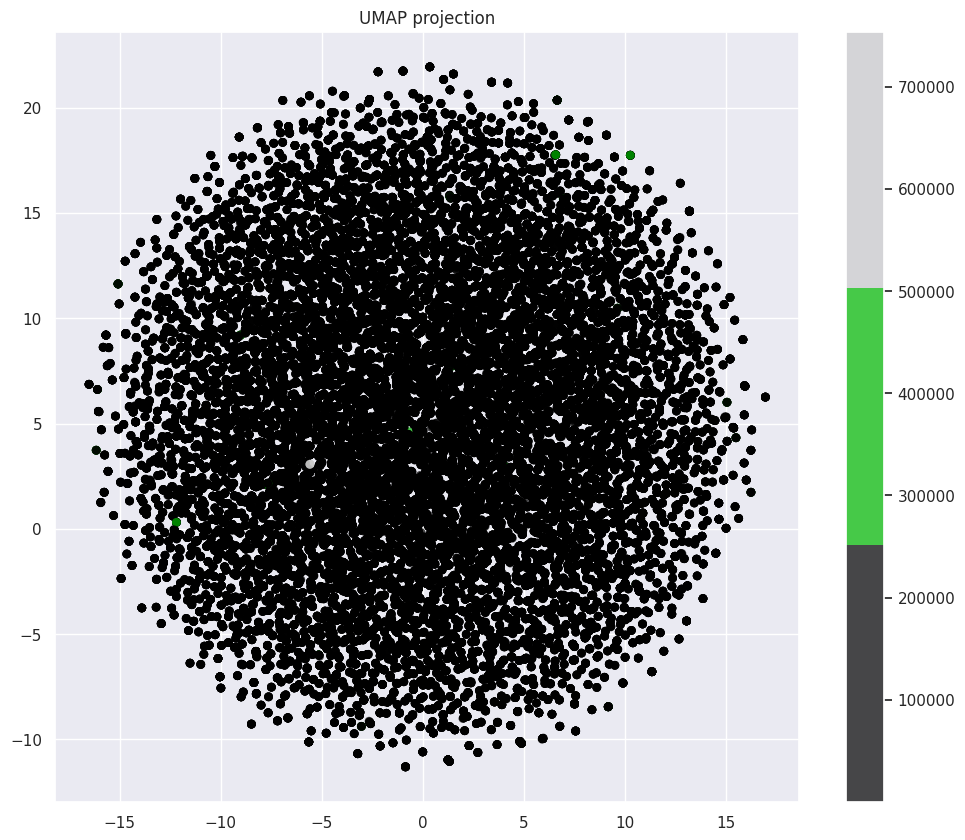

In [ ]:
plt.figure(figsize=(12,10))
plt.scatter(embeddings_umap[:, 0], embeddings_umap[:, 1], c=data['price'],
            edgecolor='none', alpha=0.7, s=40,
            cmap=plt.cm.get_cmap('nipy_spectral', 3))
plt.colorbar()
plt.title('UMAP projection');

In [ ]:
!pip install cmake==3.18.4
!pip install MulticoreTSNE

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.7/17.7 MB 21.3 MB/s eta 0:00:00
  Attempting uninstall: cmake
    Found existing installation: cmake 3.27.9
    Uninstalling cmake-3.27.9:
      Successfully uninstalled cmake-3.27.9
  Preparing metadata (setup.py) ... done
  Created wheel for MulticoreTSNE: filename=MulticoreTSNE-0.1-cp310-cp310-linux_x86_64.whl size=59533 sha256=ea3e4c277340bd723211ece2724d90ffc0550ccca804a2e7d5a12a3cb598535b
  Stored in directory: /root/.cache/pip/wheels/59/15/9b/f46b1b5a5e423feb28159b8ff44570b2089e5a53d8eba968e8
Successfully built MulticoreTSNE


In [ ]:
from MulticoreTSNE import MulticoreTSNE as TSNE

In [ ]:
# took very long to compute

tsne = TSNE(n_jobs=4)
embeddings_tsne = tsne.fit_transform(data[features_wo_nan])

KeyboardInterrupt: 

In [ ]:
plt.figure(figsize=(12,10))
plt.scatter(embeddings_tsne[:, 0], embeddings_tsne[:, 1], c=data['price'],
            edgecolor='none', alpha=0.7, s=40,
            cmap=plt.cm.get_cmap('nipy_spectral', 3))
plt.colorbar()
plt.title('t-SNE projection');

# choosing the model (experimentation)

In [ ]:
data = pd.read_csv('/content/data.csv', index_col=0)

In [ ]:
data.head()

,price,mark,model,year,equipment,mileage,place,gearbox,description,number,vin,vin_checked,accident,lease_available,seller_is_auto_ria,loan_years,loan_rate,mean_price,engine_power,tdi,ev,kwh,awd
0,13400,420.0,799.0,2016,59.0,50000,326.0,1.0,True,True,True,True,False,False,False,NaN,NaN,7864.613045,115.0,False,False,NaN,False
1,22000,50.0,3308.0,2013,NaN,181000,229.0,1.0,True,True,True,True,False,False,False,NaN,NaN,25987.084027,NaN,False,False,NaN,False
2,16500,263.0,3498.0,2012,59.0,19000,326.0,1.0,True,True,True,True,False,False,False,NaN,NaN,14491.356242,166.0,False,False,NaN,False
3,33999,50.0,3308.0,2014,295.0,250000,326.0,1.0,True,True,True,True,True,False,False,NaN,NaN,25987.084027,381.0,False,False,NaN,True
4,33500,50.0,257.0,2019,59.0,142000,326.0,1.0,True,True,True,True,False,False,False,NaN,NaN,25987.084027,190.0,False,False,NaN,True


## imports

In [ ]:
import numpy as np
import pandas as pd

In [ ]:
from sklearn.metrics import mean_squared_error

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
from sklearn.model_selection import StratifiedKFold

##splitting train/test + baseline

In [ ]:
features = [col for col in data.columns if data[col].dtype != 'O' and col != 'price']
features

['mark',
 'model',
 'year',
 'equipment',
 'mileage',
 'place',
 'gearbox',
 'description',
 'number',
 'vin',
 'vin_checked',
 'accident',
 'lease_available',
 'seller_is_auto_ria',
 'loan_years',
 'loan_rate',
 'mean_price',
 'engine_power',
 'tdi',
 'ev',
 'kwh',
 'awd']

In [ ]:
basic_features = ['mark', 'model', 'year', 'equipment', 'mileage', 'place']

In [ ]:
bin_count = 30
bin_numbers = pd.qcut(
    x=data['price'], q=bin_count, labels=False, duplicates='drop'
)

In [ ]:
train_features, test_features, train_labels, test_labels = train_test_split(data[features], data['price'], test_size=0.2, random_state=42, stratify=bin_numbers)

<Axes: >

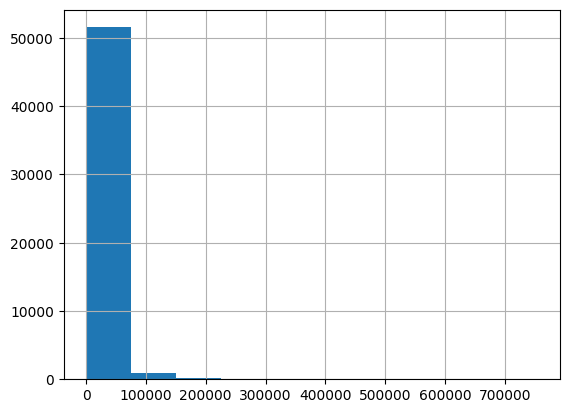

In [ ]:
train_labels.hist()

<Axes: >

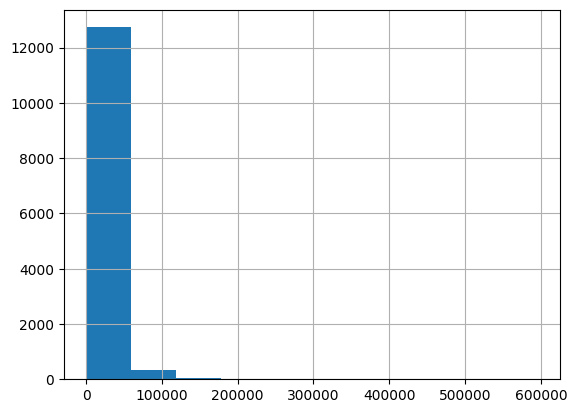

In [ ]:
test_labels.hist()

In [ ]:
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

In [ ]:
mean_squared_error(test_labels, test_features['mean_price'], squared=False)

18066.70637769775

## decision tree

In [ ]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV

In [ ]:
dt_model = DecisionTreeRegressor(random_state=26)
param_grid = {'max_depth': [4, 5, 6],
              'max_features': [2, 3, 4, 5, 6],
              'min_samples_leaf': [5, 10, 15, 20]}

dt_model_grid = GridSearchCV(dt_model, param_grid, scoring='neg_root_mean_squared_error', cv=skf)

In [ ]:
dt_model_grid.fit(train_features[basic_features], train_labels)

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_split.py:700: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(


GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=42, shuffle=True),
             estimator=DecisionTreeRegressor(random_state=26),
             param_grid={'max_depth': [4, 5, 6],
                         'max_features': [2, 3, 4, 5, 6],
                         'min_samples_leaf': [5, 10, 15, 20]},
             scoring='neg_root_mean_squared_error')

In [ ]:
dt_model_grid.best_score_

-16739.131005307714

In [ ]:
dt_model_grid.fit(train_features, train_labels)

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_split.py:700: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(


GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=42, shuffle=True),
             estimator=DecisionTreeRegressor(random_state=26),
             param_grid={'max_depth': [4, 5, 6],
                         'max_features': [2, 3, 4, 5, 6],
                         'min_samples_leaf': [5, 10, 15, 20]},
             scoring='neg_root_mean_squared_error')

In [ ]:
dt_model_grid.best_score_

-13591.439562824875

## random forest

In [ ]:
from sklearn.ensemble import RandomForestRegressor

In [ ]:
rf_model = RandomForestRegressor(random_state=26)
param_grid = {'max_depth': [4, 5, 6, 7, 8],
              'max_features': [2, 3, 4, 5, 6],
              'min_samples_leaf': [5, 10, 15, 20]}

rf_model_grid = GridSearchCV(rf_model, param_grid, scoring='neg_root_mean_squared_error', n_jobs=-1, cv=skf)

In [ ]:
rf_model_grid.fit(train_features, train_labels)

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_split.py:700: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(


GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=42, shuffle=True),
             estimator=RandomForestRegressor(random_state=26), n_jobs=-1,
             param_grid={'max_depth': [4, 5, 6, 7, 8],
                         'max_features': [2, 3, 4, 5, 6],
                         'min_samples_leaf': [5, 10, 15, 20]},
             scoring='neg_root_mean_squared_error')

In [ ]:
rf_model_grid.best_score_

-9865.55208271198

## xgboost

In [ ]:
import xgboost as xgb

In [ ]:
xgb_train = xgb.DMatrix(train_features[basic_features], train_labels, feature_names=list(basic_features))

In [ ]:
num_rounds = 10000

In [ ]:
parameters = {
    "objective": "reg:squarederror",
    "eta": 0.1,
    "verbosity": 0,
    "nthread": 4,
    "random_seed": 26,
    "eval_metric": 'rmse',

    "max_leaves": 32,
    "subsample": 0.7,
    "colsample_bytree": 0.7,
    "max_depth": 4,

    "tree_method": "hist",
    "grow_policy": "lossguide"
}

In [ ]:
xgb_cv = xgb.cv(parameters, xgb_train, num_rounds, early_stopping_rounds=10,
                      folds=skf, verbose_eval=10)

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_split.py:700: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(


[0]	train-rmse:22027.40914+198.72816	test-rmse:22031.21793+769.59041
[10]	train-rmse:18144.73080+242.83288	test-rmse:18249.81611+889.56145
[20]	train-rmse:16588.94494+308.83596	test-rmse:16821.16601+841.45093
[30]	train-rmse:15668.42638+248.33717	test-rmse:16047.08362+910.63298
[40]	train-rmse:14940.23619+220.66856	test-rmse:15498.25880+925.98741
[50]	train-rmse:14517.64402+167.72996	test-rmse:15151.59420+948.06630
[60]	train-rmse:14135.12248+125.53252	test-rmse:14851.77623+949.98925
[70]	train-rmse:13786.15857+122.20045	test-rmse:14580.39027+931.21685
[80]	train-rmse:13484.30252+129.28048	test-rmse:14385.99993+900.65854
[90]	train-rmse:13197.11381+151.42977	test-rmse:14174.84135+932.32582
[100]	train-rmse:12950.33893+144.10122	test-rmse:13972.73090+908.82771
[110]	train-rmse:12760.62662+139.58354	test-rmse:13877.39952+878.89322
[120]	train-rmse:12601.23747+144.00544	test-rmse:13773.53863+873.32725
[130]	train-rmse:12461.70704+154.53395	test-rmse:13696.12247+898.27969
[140]	train-rmse:

In [ ]:
xgb_train = xgb.DMatrix(train_features, train_labels, feature_names=list(features))

In [ ]:
xgb_cv = xgb.cv(parameters, xgb_train, num_rounds, early_stopping_rounds=10,
                      folds=skf, verbose_eval=10)

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_split.py:700: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(


[0]	train-rmse:20983.41113+179.28884	test-rmse:21032.31282+804.82088
[10]	train-rmse:13762.12358+190.14169	test-rmse:14174.01605+1008.53592
[20]	train-rmse:11205.65574+218.86186	test-rmse:11849.48468+1113.88720
[30]	train-rmse:10222.79026+184.80117	test-rmse:10923.98589+1021.62634
[40]	train-rmse:9682.41164+220.46519	test-rmse:10485.53539+993.59060
[50]	train-rmse:9294.36849+210.68761	test-rmse:10176.40233+919.59173
[60]	train-rmse:8988.36249+178.05814	test-rmse:9915.32928+827.97311
[70]	train-rmse:8807.69555+186.28523	test-rmse:9760.72040+801.62105
[80]	train-rmse:8627.98955+169.66683	test-rmse:9640.56481+801.81591
[90]	train-rmse:8459.23018+144.72408	test-rmse:9528.10892+790.97867
[100]	train-rmse:8308.62501+118.04903	test-rmse:9446.21576+790.71416
[110]	train-rmse:8193.93204+108.87282	test-rmse:9379.03832+796.72797
[120]	train-rmse:8061.84705+95.97216	test-rmse:9316.16568+799.05845
[130]	train-rmse:7932.30247+82.60402	test-rmse:9243.55839+798.32517
[140]	train-rmse:7802.33113+80.631

## lightgbm

In [ ]:
import lightgbm as lgb

In [ ]:
lgb_train = lgb.Dataset(train_features[basic_features], train_labels, free_raw_data=False)

In [ ]:
n_rounds = 10000

In [ ]:
parameters = {
    #default
    "objective": "regression",
    "learning_rate": 0.1,
    "num_threads": 10,
    "seed": 26,

    #regularization
    "colsample_bytree": 0.9,
    "subsample": 0.9,
    "subsample_freq": 1,
    "min_data_in_leaf": 5,

    "verbose":-1
}

In [ ]:
# only basic features
result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=10)])

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_split.py:700: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(


Training until validation scores don't improve for 10 rounds
[10]	cv_agg's train rmse: 15662.2 + 191.998	cv_agg's valid rmse: 16342.9 + 1073.6
[20]	cv_agg's train rmse: 13197.3 + 143.766	cv_agg's valid rmse: 14389.1 + 1271.81
[30]	cv_agg's train rmse: 11982.4 + 138.158	cv_agg's valid rmse: 13541.3 + 1356.95
[40]	cv_agg's train rmse: 11170.3 + 127.014	cv_agg's valid rmse: 13011.9 + 1415.25
[50]	cv_agg's train rmse: 10575.5 + 115.853	cv_agg's valid rmse: 12678 + 1439.98
[60]	cv_agg's train rmse: 10130.1 + 96.454	cv_agg's valid rmse: 12447.3 + 1446.8
[70]	cv_agg's train rmse: 9786.47 + 91.9401	cv_agg's valid rmse: 12268.8 + 1448.66
[80]	cv_agg's train rmse: 9484.13 + 95.1748	cv_agg's valid rmse: 12123.2 + 1437.66
[90]	cv_agg's train rmse: 9211.74 + 115.512	cv_agg's valid rmse: 12035.6 + 1460.86
[100]	cv_agg's train rmse: 8991.35 + 113.567	cv_agg's valid rmse: 11961.6 + 1446.51
[110]	cv_agg's train rmse: 8791.48 + 95.9277	cv_agg's valid rmse: 11892.9 + 1457.73
[120]	cv_agg's train rmse: 86

In [ ]:
# trying on all features
lgb_train = lgb.Dataset(train_features, train_labels, free_raw_data=False)

In [ ]:
result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=10)])

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_split.py:700: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(


Training until validation scores don't improve for 10 rounds
[10]	cv_agg's train rmse: 11926.8 + 98.2858	cv_agg's valid rmse: 12386.9 + 770.38
[20]	cv_agg's train rmse: 8582.31 + 58.5633	cv_agg's valid rmse: 9406.19 + 542.881
[30]	cv_agg's train rmse: 7416.33 + 61.7671	cv_agg's valid rmse: 8429.96 + 439.978
[40]	cv_agg's train rmse: 6835.97 + 59.394	cv_agg's valid rmse: 7972.08 + 411.046
[50]	cv_agg's train rmse: 6462.93 + 48.7262	cv_agg's valid rmse: 7750.55 + 433.341
[60]	cv_agg's train rmse: 6186.35 + 50.852	cv_agg's valid rmse: 7611.46 + 477.022
[70]	cv_agg's train rmse: 5991.37 + 60.3977	cv_agg's valid rmse: 7478.86 + 483.556
[80]	cv_agg's train rmse: 5832.76 + 52.335	cv_agg's valid rmse: 7400.28 + 483.299
[90]	cv_agg's train rmse: 5690.05 + 52.0759	cv_agg's valid rmse: 7301.43 + 495.267
[100]	cv_agg's train rmse: 5566.6 + 60.9638	cv_agg's valid rmse: 7239.66 + 517.746
[110]	cv_agg's train rmse: 5454.05 + 50.3171	cv_agg's valid rmse: 7187.38 + 510.587
[120]	cv_agg's train rmse: 53

### tuning hyperparameters

In [ ]:
# going back to basic features to tune hyperparameters
lgb_train = lgb.Dataset(train_features[basic_features], train_labels, free_raw_data=False)

In [ ]:
# comparing to:
# [288]	cv_agg's train rmse: 6865.36 + 103.776	cv_agg's valid rmse: 11404.6 + 1463.85
# no improvement:
# [288]	cv_agg's train rmse: 6865.36 + 103.776	cv_agg's valid rmse: 11404.6 + 1463.85

parameters = {
    #default
    "objective": "regression",
    "learning_rate": 0.1,
    "num_threads": 10,
    "seed": 26,

    #regularization
    "colsample_bytree": 0.8,
    "subsample": 0.9,
    "subsample_freq": 1,
    "min_data_in_leaf": 5,

    "verbose":-1
}

result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=10)])

In [ ]:
# comparing to:
# [288]	cv_agg's train rmse: 6865.36 + 103.776	cv_agg's valid rmse: 11404.6 + 1463.85
# no improvement:
# [288]	cv_agg's train rmse: 6866.14 + 96.7202	cv_agg's valid rmse: 11438.9 + 1465.21

parameters = {
    #default
    "objective": "regression",
    "learning_rate": 0.1,
    "num_threads": 10,
    "seed": 26,

    #regularization
    "colsample_bytree": 0.9,
    "subsample": 0.8,
    "subsample_freq": 1,
    "min_data_in_leaf": 5,

    "verbose":-1
}

result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=10)])

In [ ]:
# comparing to:
# [288]	cv_agg's train rmse: 6865.36 + 103.776	cv_agg's valid rmse: 11404.6 + 1463.85
# no improvement:
# [265]	cv_agg's train rmse: 7753.3 + 147.225	cv_agg's valid rmse: 11414.7 + 1242.12

parameters = {
    #default
    "objective": "regression",
    "learning_rate": 0.1,
    "num_threads": 10,
    "seed": 26,

    #regularization
    "colsample_bytree": 0.9,
    "subsample": 0.9,
    "subsample_freq": 1,
    "min_data_in_leaf": 10,

    "verbose":-1
}

result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=10)])

In [ ]:
# comparing to:
# [288]	cv_agg's train rmse: 6865.36 + 103.776	cv_agg's valid rmse: 11404.6 + 1463.85

parameters = {
    #default
    "objective": "regression",
    "learning_rate": 0.1,
    "num_threads": 10,
    "seed": 26,

    #regularization
    "colsample_bytree": 0.9,
    "subsample": 0.9,
    "subsample_freq": 1,
    "min_data_in_leaf": 4,

    "verbose":-1
}

result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=10)])

In [ ]:
# comparing to:
# [288]	cv_agg's train rmse: 6620.47 + 79.2106	cv_agg's valid rmse: 11293.8 + 1370.64

parameters = {
    #default
    "objective": "regression",
    "learning_rate": 0.1,
    "num_threads": 10,
    "seed": 26,

    #regularization
    "colsample_bytree": 0.9,
    "subsample": 0.9,
    "subsample_freq": 1,
    "min_data_in_leaf": 3,

    "verbose":-1
}

result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=10)])

In [ ]:
# comparing to:
# [333]	cv_agg's train rmse: 6056.79 + 56.3811	cv_agg's valid rmse: 11228.7 + 1356.46

parameters = {
    #default
    "objective": "regression",
    "learning_rate": 0.1,
    "num_threads": 10,
    "seed": 26,

    #regularization
    "colsample_bytree": 0.9,
    "subsample": 0.9,
    "subsample_freq": 1,
    "min_data_in_leaf": 2,

    "verbose":-1
}

result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=10)])

In [ ]:
# comparing to:
# [408]	cv_agg's train rmse: 5370.67 + 43.3584	cv_agg's valid rmse: 11191.2 + 1486.99

parameters = {
    #default
    "objective": "regression",
    "learning_rate": 0.1,
    "num_threads": 10,
    "seed": 26,

    #regularization
    "colsample_bytree": 0.9,
    "subsample": 0.9,
    "subsample_freq": 1,
    "min_data_in_leaf": 1,

    "verbose":-1
}

result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=10)])

In [ ]:
# comparing to:
# [509]	cv_agg's train rmse: 4668.7 + 33.683	cv_agg's valid rmse: 11048.4 + 1486.55
# no improvement:
# [290]	cv_agg's train rmse: 4522.88 + 43.5538	cv_agg's valid rmse: 11304.1 + 1362.17

parameters = {
    #default
    "objective": "regression",
    "learning_rate": 0.2,
    "num_threads": 10,
    "seed": 26,

    #regularization
    "colsample_bytree": 0.9,
    "subsample": 0.9,
    "subsample_freq": 1,
    "min_data_in_leaf": 1,

    "verbose":-1
}

result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=10)])

In [ ]:
# comparing to:
# [509]	cv_agg's train rmse: 4668.7 + 33.683	cv_agg's valid rmse: 11048.4 + 1486.55

parameters = {
    #default
    "objective": "regression",
    "learning_rate": 0.05,
    "num_threads": 10,
    "seed": 26,

    #regularization
    "colsample_bytree": 0.9,
    "subsample": 0.9,
    "subsample_freq": 1,
    "min_data_in_leaf": 1,

    "verbose":-1
}

result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=10)])

In [ ]:
# comparing to:
# [1178]	cv_agg's train rmse: 4428.07 + 42.1315	cv_agg's valid rmse: 10832.1 + 1635.94
# no improvement:
# [704]	cv_agg's train rmse: 4617.56 + 40.6597	cv_agg's valid rmse: 10947.4 + 1572.78

parameters = {
    #default
    "objective": "regression",
    "learning_rate": 0.075,
    "num_threads": 10,
    "seed": 26,

    #regularization
    "colsample_bytree": 0.9,
    "subsample": 0.9,
    "subsample_freq": 1,
    "min_data_in_leaf": 1,

    "verbose":-1
}

result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=10)])

In [ ]:
# comparing to:
# [1178]	cv_agg's train rmse: 4428.07 + 42.1315	cv_agg's valid rmse: 10832.1 + 1635.94
# the same result
# the best parameters as they allow for stronger regularisation with the same result

parameters = {
    #default
    "objective": "regression",
    "learning_rate": 0.05,
    "num_threads": 10,
    "seed": 26,

    #regularization
    "colsample_bytree": 0.8,
    "subsample": 0.9,
    "subsample_freq": 1,
    "min_data_in_leaf": 1,

    "verbose":-1
}

result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=10)])

In [ ]:
# comparing to:
# [1178]	cv_agg's train rmse: 4428.07 + 42.1315	cv_agg's valid rmse: 10832.1 + 1635.94
# no improvement:
# [853]	cv_agg's train rmse: 4958.04 + 45.2417	cv_agg's valid rmse: 10849.4 + 1496.4

parameters = {
    #default
    "objective": "regression",
    "learning_rate": 0.05,
    "num_threads": 10,
    "seed": 26,

    #regularization
    "colsample_bytree": 0.8,
    "subsample": 0.8,
    "subsample_freq": 1,
    "min_data_in_leaf": 1,

    "verbose":-1
}

result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=10)])

### testing features

In [ ]:
parameters = {
    #default
    "objective": "regression",
    "learning_rate": 0.05,
    "num_threads": 10,
    "seed": 26,

    #regularization
    "colsample_bytree": 0.8,
    "subsample": 0.9,
    "subsample_freq": 1,
    "min_data_in_leaf": 1,

    "verbose":-1
}

In [ ]:
# adding other features one by one and testing them
[x for x in features if x not in basic_features]

['gearbox',
 'description',
 'number',
 'vin',
 'vin_checked',
 'accident',
 'lease_available',
 'seller_is_auto_ria',
 'loan_years',
 'loan_rate',
 'mean_price',
 'engine_power',
 'tdi',
 'ev',
 'kwh',
 'awd']

In [ ]:
# comparing to:
# [1178]	cv_agg's train rmse: 4428.07 + 42.1315	cv_agg's valid rmse: 10832.1 + 1635.94
# no improvement:
# [955]	cv_agg's train rmse: 4615.34 + 32.6475	cv_agg's valid rmse: 10953.2 + 1569.08

add_features = basic_features + ['gearbox']
lgb_train = lgb.Dataset(train_features[add_features], train_labels, free_raw_data=False)
result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=10)])

In [ ]:
# comparing to:
# [1178]	cv_agg's train rmse: 4428.07 + 42.1315	cv_agg's valid rmse: 10832.1 + 1635.94

add_features = basic_features + ['description']
lgb_train = lgb.Dataset(train_features[add_features], train_labels, free_raw_data=False)
result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=50)])

In [ ]:
# comparing to:
# [1125]	cv_agg's train rmse: 4473.48 + 48.7744	cv_agg's valid rmse: 10797.9 + 1536.58
# no improvement:
# [893]	cv_agg's train rmse: 4933.43 + 46.6908	cv_agg's valid rmse: 10836.7 + 1541.58

basic_features = add_features[:]
add_features = basic_features + ['number']
lgb_train = lgb.Dataset(train_features[add_features], train_labels, free_raw_data=False)
result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=50)])

In [ ]:
# comparing to:
# [1125]	cv_agg's train rmse: 4473.48 + 48.7744	cv_agg's valid rmse: 10797.9 + 1536.58
# no improvement:
# [892]	cv_agg's train rmse: 4909.06 + 36.7725	cv_agg's valid rmse: 10887.2 + 1559.33

add_features = basic_features + ['vin']
lgb_train = lgb.Dataset(train_features[add_features], train_labels, free_raw_data=False)
result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=50)])

In [ ]:
# comparing to:
# [1125]	cv_agg's train rmse: 4473.48 + 48.7744	cv_agg's valid rmse: 10797.9 + 1536.58
# no improvement:
# [893]	cv_agg's train rmse: 4904.21 + 43.5635	cv_agg's valid rmse: 10803.2 + 1541.19

add_features = basic_features + ['vin_checked']
lgb_train = lgb.Dataset(train_features[add_features], train_labels, free_raw_data=False)
result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=50)])

In [ ]:
# comparing to:
# [1125]	cv_agg's train rmse: 4473.48 + 48.7744	cv_agg's valid rmse: 10797.9 + 1536.58

add_features = basic_features + ['accident']
lgb_train = lgb.Dataset(train_features[add_features], train_labels, free_raw_data=False)
result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=50)])

In [ ]:
# comparing to:
# [1179]	cv_agg's train rmse: 4440.04 + 39.549	cv_agg's valid rmse: 10759.8 + 1668.34
# no improvement:
# [1052]	cv_agg's train rmse: 4610.72 + 40.4651	cv_agg's valid rmse: 10843.2 + 1454.77

basic_features = add_features[:]
add_features = basic_features + ['lease_available']
lgb_train = lgb.Dataset(train_features[add_features], train_labels, free_raw_data=False)
result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=50)])

In [ ]:
# comparing to:
# [1179]	cv_agg's train rmse: 4440.04 + 39.549	cv_agg's valid rmse: 10759.8 + 1668.34
# no improvement:
# [1036]	cv_agg's train rmse: 4644.43 + 30.4313	cv_agg's valid rmse: 10768.9 + 1454.34

add_features = basic_features + ['seller_is_auto_ria']
lgb_train = lgb.Dataset(train_features[add_features], train_labels, free_raw_data=False)
result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=50)])

In [ ]:
# comparing to:
# [1179]	cv_agg's train rmse: 4440.04 + 39.549	cv_agg's valid rmse: 10759.8 + 1668.34
# no improvement:
# [890]	cv_agg's train rmse: 4844.62 + 23.2649	cv_agg's valid rmse: 10930 + 1531.46

add_features = basic_features + ['loan_years']
lgb_train = lgb.Dataset(train_features[add_features], train_labels, free_raw_data=False)
result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=50)])

In [ ]:
# comparing to:
# [1179]	cv_agg's train rmse: 4440.04 + 39.549	cv_agg's valid rmse: 10759.8 + 1668.34
# no improvement:
# [968]	cv_agg's train rmse: 4716.37 + 36.0784	cv_agg's valid rmse: 10892.1 + 1547.78

add_features = basic_features + ['loan_rate']
lgb_train = lgb.Dataset(train_features[add_features], train_labels, free_raw_data=False)
result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=50)])

In [ ]:
# comparing to:
# [1179]	cv_agg's train rmse: 4440.04 + 39.549	cv_agg's valid rmse: 10759.8 + 1668.34

add_features = basic_features + ['mean_price']
lgb_train = lgb.Dataset(train_features[add_features], train_labels, free_raw_data=False)
result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=50)])

In [ ]:
# comparing to:
# [847]	cv_agg's train rmse: 4363.29 + 22.8011	cv_agg's valid rmse: 7309.19 + 372.785

basic_features = add_features[:]
add_features = basic_features + ['engine_power']
lgb_train = lgb.Dataset(train_features[add_features], train_labels, free_raw_data=False)
result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=50)])

In [ ]:
# comparing to:
# [661]	cv_agg's train rmse: 4029.77 + 44.9731	cv_agg's valid rmse: 6910.81 + 449.764
# no improvement:
# [661]	cv_agg's train rmse: 4014.69 + 45.5244	cv_agg's valid rmse: 7011.03 + 527.447

basic_features = add_features[:]
add_features = basic_features + ['tdi']
lgb_train = lgb.Dataset(train_features[add_features], train_labels, free_raw_data=False)
result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=50)])

In [ ]:
# comparing to:
# [661]	cv_agg's train rmse: 4029.77 + 44.9731	cv_agg's valid rmse: 6910.81 + 449.764
# no improvement:
# [524]	cv_agg's train rmse: 4297.46 + 28.0151	cv_agg's valid rmse: 7092.95 + 513.634

add_features = basic_features + ['ev']
lgb_train = lgb.Dataset(train_features[add_features], train_labels, free_raw_data=False)
result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=50)])

In [ ]:
# comparing to:
# [661]	cv_agg's train rmse: 4029.77 + 44.9731	cv_agg's valid rmse: 6910.81 + 449.764
# no improvement:
# [605]	cv_agg's train rmse: 4108.67 + 44.5412	cv_agg's valid rmse: 7048.94 + 506.985

add_features = basic_features + ['kwh']
lgb_train = lgb.Dataset(train_features[add_features], train_labels, free_raw_data=False)
result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=50)])

In [ ]:
# comparing to:
# [661]	cv_agg's train rmse: 4029.77 + 44.9731	cv_agg's valid rmse: 6910.81 + 449.764
# no improvement:
# [790]	cv_agg's train rmse: 3788.51 + 54.1642	cv_agg's valid rmse: 6941.01 + 521.993

add_features = basic_features + ['awd']
lgb_train = lgb.Dataset(train_features[add_features], train_labels, free_raw_data=False)
result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=50)])

### final model

In [ ]:
final_features = ['mark', 'model', 'year', 'equipment', 'mileage', 'place',
                  'description', 'accident', 'mean_price', 'engine_power']

In [ ]:
lgb_train = lgb.Dataset(train_features[final_features], train_labels, free_raw_data=False)
result = lgb.cv(parameters, lgb_train, n_rounds, folds=skf, metrics='rmse', eval_train_metric=True, callbacks=[lgb.early_stopping(10), lgb.log_evaluation(period=50)])

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_split.py:700: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(


Training until validation scores don't improve for 10 rounds
[50]	cv_agg's train rmse: 7907.31 + 38.1611	cv_agg's valid rmse: 9064.25 + 482.224
[100]	cv_agg's train rmse: 6372.83 + 31.6641	cv_agg's valid rmse: 7828.04 + 455.478
[150]	cv_agg's train rmse: 5801.66 + 31.4526	cv_agg's valid rmse: 7496.5 + 442.203
[200]	cv_agg's train rmse: 5445.96 + 30.2927	cv_agg's valid rmse: 7346.26 + 444.411
[250]	cv_agg's train rmse: 5177.13 + 21.3026	cv_agg's valid rmse: 7245.13 + 448.274
[300]	cv_agg's train rmse: 4959.52 + 23.1718	cv_agg's valid rmse: 7168.96 + 460.387
[350]	cv_agg's train rmse: 4779.4 + 31.6643	cv_agg's valid rmse: 7112.6 + 465.485
[400]	cv_agg's train rmse: 4624.67 + 29.1761	cv_agg's valid rmse: 7069.66 + 461.119
[450]	cv_agg's train rmse: 4494.78 + 32.9712	cv_agg's valid rmse: 7041.6 + 465.789
[500]	cv_agg's train rmse: 4366.21 + 40.1258	cv_agg's valid rmse: 6999.96 + 462.22
[550]	cv_agg's train rmse: 4250.23 + 37.6963	cv_agg's valid rmse: 6977.85 + 450.544
[600]	cv_agg's train 

In [ ]:
lgb_model = lgb.train(parameters, lgb_train, num_boost_round=len(result['train rmse-mean']))

In [ ]:
lgb_model.save_model('model.txt', num_iteration=lgb_model.best_iteration)

# testing (the result)

In [ ]:
import lightgbm as lgb

In [ ]:
lgb_model = lgb.Booster(model_file='/content/model.txt')

In [ ]:
lgb_prediction = lgb_model.predict(test_features[final_features])

In [ ]:
lgb_prediction

array([15987.81789831,   168.82007802,  9606.13311232, ...,
       10239.61896605, 23830.85579312, 13955.77796345])

In [ ]:
mean_squared_error(test_labels, lgb_prediction, squared=False)

7874.002275147693

# model interpretation

<Axes: title={'center': 'Feature importance'}, xlabel='Feature importance', ylabel='Features'>

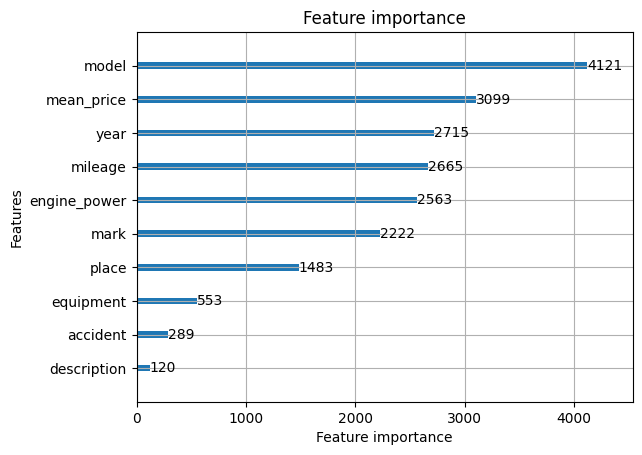

In [ ]:
lgb.plot_importance(lgb_model)

In [ ]:
import numpy as np
import pandas as pd

## shap

In [ ]:
!pip install shap

In [ ]:
import shap

explainer = shap.TreeExplainer(lgb_model, model_output="raw", feature_perturbation="tree_path_dependent")

In [ ]:
shap.initjs()
subsampled_data = train_features[final_features].sample(n=2000, random_state=42)

shap_values = explainer.shap_values(subsampled_data)
shap.force_plot(explainer.expected_value, shap_values, subsampled_data)

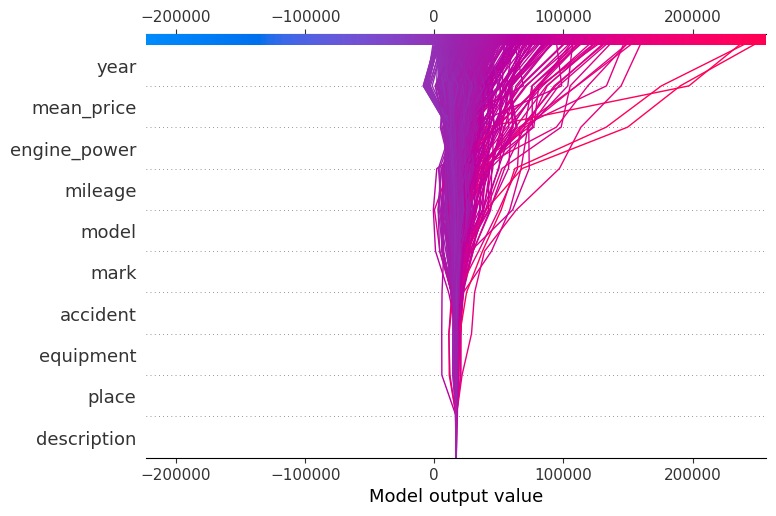

In [ ]:
shap.decision_plot(explainer.expected_value, shap_values, final_features)

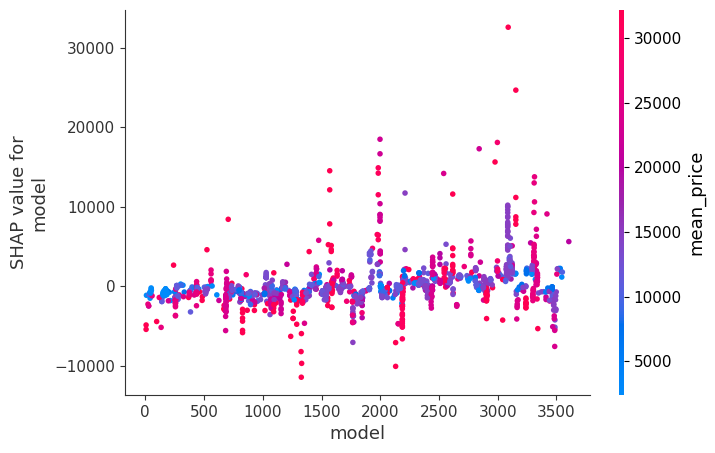

In [ ]:
shap.dependence_plot("model", shap_values, subsampled_data)

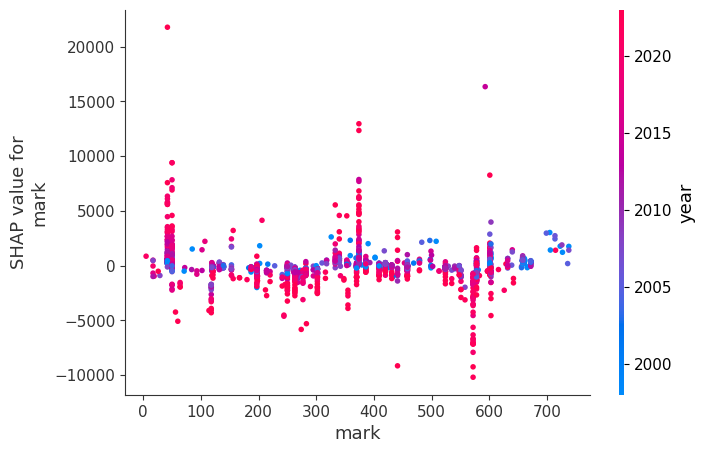

In [ ]:
shap.dependence_plot("mark", shap_values, subsampled_data)

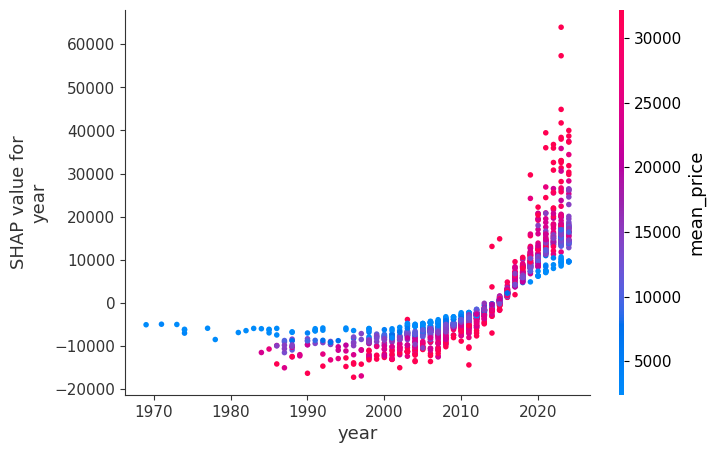

In [ ]:
shap.dependence_plot("year", shap_values, subsampled_data)

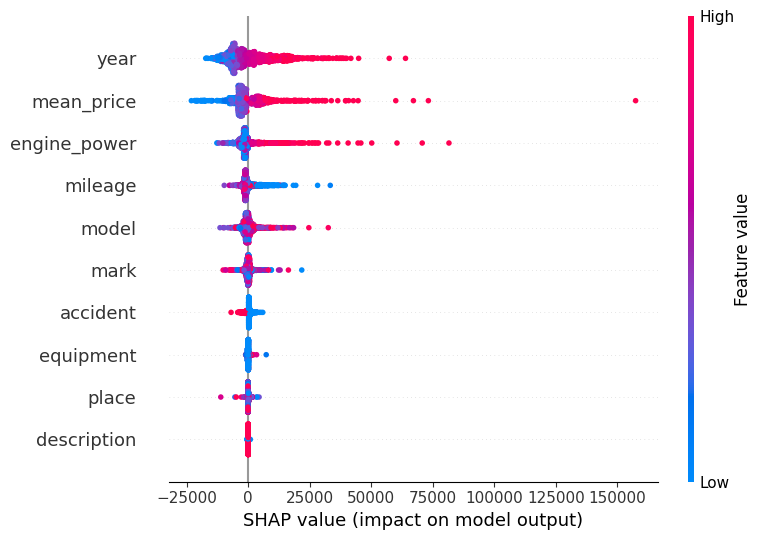

In [ ]:
shap.summary_plot(shap_values, subsampled_data)